# SVM и его ядра
__Суммарное количество баллов: 9__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[HSE][ML][MS][HW07] <ФИ>`, где вместо `<ФИ>` указаны фамилия и имя__

В этом задании нам предстоит решить задачу SVM при помощи `cvxopt` и применить ее к искуственным данным. Затем аналогичным способом нужно будет решить задачу ядерного SVM и исследовать его поведение для различных ядер и значений их параметров.

In [1]:
import numpy as np
import copy
from cvxopt import spmatrix, matrix, solvers
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification, make_moons, make_blobs
from typing import NoReturn, Callable

solvers.options['show_progress'] = False

In [2]:
def visualize(clf, X, y):
    x_min, x_max = X[:, 0].min(), X[:, 0].max()
    y_min, y_max = X[:, 1].min(), X[:, 1].max()
    x_border = (x_max - x_min) / 20 + 1.0e-3
    x_h = (x_max - x_min + 2 * x_border) / 200
    y_border = (y_max - y_min) / 20 + 1.0e-3
    y_h = (y_max - y_min + 2 * y_border) / 200
    
    cm = plt.cm.Spectral

    xx, yy = np.meshgrid(np.arange(x_min - x_border, x_max + x_border, x_h), np.arange(y_min - y_border, y_max + y_border, y_h))
    mesh = np.c_[xx.ravel(), yy.ravel()]

    z_class = clf.predict(mesh).reshape(xx.shape)

    # Put the result into a color plot
    plt.figure(1, figsize=(8, 8))
    plt.pcolormesh(xx, yy, z_class, cmap=cm, alpha=0.3, shading='gouraud')

    # Plot hyperplane and margin
    z_dist = clf.decision_function(mesh).reshape(xx.shape)
    plt.contour(xx, yy, z_dist, [0.0], colors='black')
    plt.contour(xx, yy, z_dist, [-1.0, 1.0], colors='black', linestyles='dashed')

    # Plot also the training points
    y_pred = clf.predict(X)

    ind_support = []
    ind_correct = []
    ind_incorrect = []
    for i in range(len(y)):
        if i in clf.support:
            ind_support.append(i)
        elif y[i] == y_pred[i]:
            ind_correct.append(i)
        else:
            ind_incorrect.append(i)

    plt.scatter(X[ind_correct, 0], X[ind_correct, 1], c=y[ind_correct], cmap=cm, alpha=1., edgecolor='black', linewidth=.8)
    plt.scatter(X[ind_incorrect, 0], X[ind_incorrect, 1], c=y[ind_incorrect], cmap=cm, alpha=1., marker='*',
               s=50, edgecolor='black', linewidth=.8)
    plt.scatter(X[ind_support, 0], X[ind_support, 1], c=y[ind_support], cmap=cm, alpha=1., edgecolor='yellow', linewidths=1.,
               s=40)

    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.tight_layout()

In [3]:
def generate_dataset(moons=False):
    if moons:
        X, y = make_moons(1000, noise=0.075, random_state=42)
        return X, 2 * y - 1
    X, y = make_blobs(1000, 2, centers=[[0, 0], [-4, 2], [3.5, -2.0], [3.5, 3.5]], random_state=42)
    y = 2 * (y % 2) - 1
    return X, y

X, y = generate_dataset(True)

### Задание 1 (2 балла)
Для начала реализуем обычный линейный SVM. 

#### Методы
`fit(X, y)` - обучает SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Поля
`support` - индексы опорных элементов

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

А наша задача формулируется так:

$\begin{cases}0.5 \cdot w^\text{T}w + C \cdot \sum \xi_i \rightarrow \min_{w, \xi} \\ \xi \geq 0 \\ y_i (w^\text{T}x_i + w_0) \geq 1 - \xi_i \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = (w, w_0, \xi) \\ P = 
\left[
    \begin{array}{c|c}
      I & 0\\
      \hline
      0 & 0
    \end{array}
\right] \\ 
q = \left[
    \begin{array}{c}
      0 \\
      \hline
      C 
    \end{array}
\right] \\ 
 G = 
\left[
    \begin{array}{c|c|c}
      0 & 0 & -I\\
      \hline
      -yX & -y & -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      0 \\
      \hline
      -1 
    \end{array}
\right] $

In [4]:
class LinearSVM:
    def __init__(self, C: float):
        self.C = C
        self.support = None

    def fit(self, X: np.ndarray, y: np.ndarray) -> NoReturn:
        x_num = X.shape[0]
        x_size = X.shape[1]
        self.P = matrix(np.block([[np.eye(x_num), np.zeros((x_num, x_size + 1))],
                             [np.zeros((x_size + 1, x_num)), np.zeros((x_size + 1,x_size + 1))]         
        ]))

        self.q = matrix(np.block([np.zeros(x_size + 1), 
                             np.full(x_num, self.C)       
        ]))
        y = y.reshape(-1, 1)
        self.G = matrix(np.block([
            [np.zeros_like(X), np.zeros((x_num, 1)), -np.eye(x_num)],
            [-y * X, -y, -np.eye(x_num)]
        ]))
        self.h = matrix(np.block([
            [np.zeros((x_num, 1))],
            [np.full((x_num, 1), -1)]              
        ]))
        res = solvers.qp(self.P, self.q, self.G, self.h)
        res_x = np.asarray(res['x'])

        self.W, self.b = res_x[:x_size], res_x[x_size]
        
        mask = np.squeeze(res_x[x_size + 1:] > 1.0e-3)
        self.support = np.arange(len(mask))[mask]

    def decision_function(self, X: np.ndarray) -> np.ndarray:
        return (X @ self.W + self.b)

    def predict(self, X: np.ndarray) -> np.ndarray:
        return np.sign(self.decision_function(X))

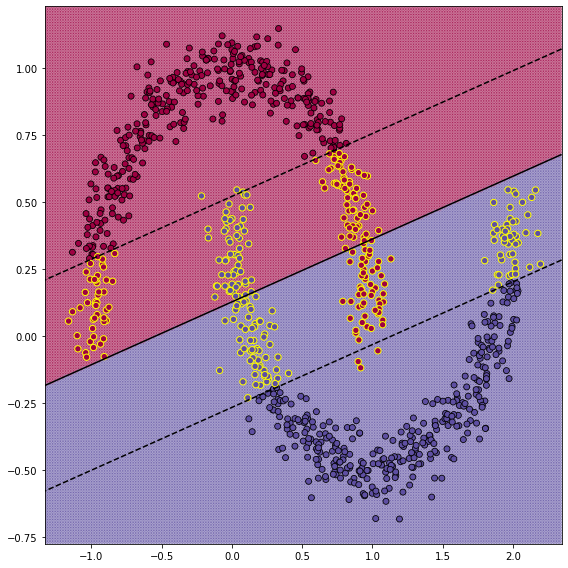

In [5]:
X, y = generate_dataset(True)
svm = LinearSVM(1)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

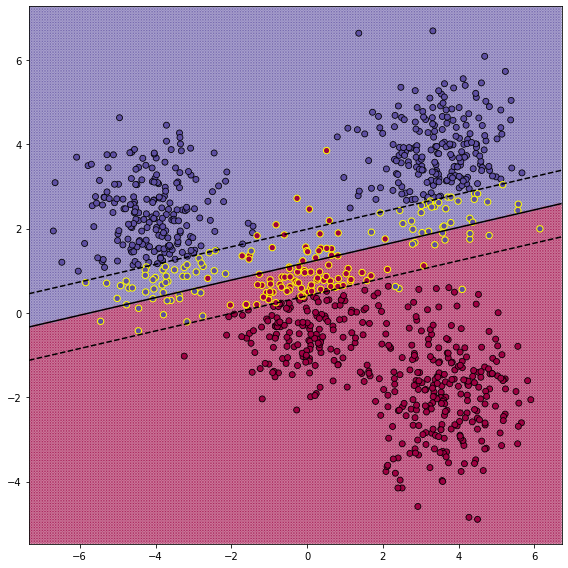

In [6]:
X, y = generate_dataset(False)
svm = LinearSVM(1)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

### Задание 2 (2 балла)
Перед реализацией ядерного SVM, реализуем функции, которые строят ядра.

#### Описание
`get_polynomial_kernel(power)` - возвращает полиномиальное ядро с заданной константой и степенью

`get_gaussian_kernel(sigma=1.)` - возвращает ядро Гаусса с заданным коэффицинтом сигма

In [7]:
def get_polynomial_kernel(c=1, power=2):
    def poly(u,v):
      return (u @ v + c) ** power
    return poly

def get_gaussian_kernel(sigma=1.):
    def gaussian(u, v):
      if len(u.shape) == 1:
          return np.exp(-sigma * np.linalg.norm(v - u) ** 2)
      else:
          return np.exp(-sigma * np.linalg.norm(v - u, axis=1) ** 2)
    return gaussian

### Задание 3 (2 балла)
Теперь перейдем к реализации самого kernel SVM.

#### Описание
`fit(X, y)` - обучает kernel SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Конструктор
`kernel` - ядро-функция

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

Будем решать двойственную задачу. Формулируется она так:

$\begin{cases}\sum \alpha_i - 0.5 \sum \alpha_i \alpha_j y_i y_j K(x_i, x_j) \rightarrow \max_{\alpha}\\ C \geq \alpha \geq 0 \\ \sum y_i \alpha_i = 0 \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = \alpha \\ P = 
\left[ y_i y_j K(y_i, y_j) \right] \\ 
q = \left[ -1
\right] \\ 
 G = 
\left[
    \begin{array}{c}
      I\\
      \hline
      -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      C \\
      \hline
      0 
    \end{array}
\right] \\
b = 0\\
A = y^\text{T}$

В таком случае решающей функцией будет:

$a(x) = \text{sign} (\sum \alpha_i y_i K(x, x_i) + w_0)$, где $w_0 = \frac{1}{n}\sum\limits_{i=1}^{n}[y_i - \sum \alpha_j y_j K(x_i, x_j)]$

In [60]:
class KernelSVM:
    def __init__(self, C: float, kernel: Callable = get_polynomial_kernel):

        self.C = C
        self.kernel = kernel 
        self.support = None

    def fit(self, X: np.ndarray, y: np.ndarray) -> NoReturn:     

        self.X = X
        self.n = X.shape[0]


        K = np.zeros((self.n, self.n))
        for i in range(self.n):
            for j in range(self.n):
                K[i,j] = self.kernel(X[i], X[j])

        self.P = matrix(K * [[i * j for i in y] for j in y])
        self.q = matrix(-np.ones(self.n))
        self.G = matrix(np.block([
                        [np.eye(self.n)], [-np.eye(self.n)]
                        ]))
        self.h = matrix(np.block(
            [np.full(self.n, self.C), np.zeros(self.n)]))
        self.b = matrix(0.)
        self.A = matrix(y.reshape(1, -1,).astype('float64'))
        self.a = solvers.qp(self.P, self.q, self.G, self.h, self.A, self.b)
        self.a = np.asarray(self.a['x'])

        def w_func(a, y, x, size, i):
            w_i = [(a * y)[0][i] * x[j,i] for j in range(self.n)]
            return np.sum(w_i)

        w = [w_func(self.a.T , y, K, self.n, i) for i in range(self.n)]
        self.b = np.mean(y - np.array(w))

        self.support = np.zeros(self.n) + self.b
        for i in range(self.n):
            self.support += (self.a.T * y)[0][i] * self.kernel(X, X[i])
        mask = self.support * y <= 1
        self.support = np.arange(len(mask))[mask]

    def decision_function(self, X: np.ndarray) -> np.ndarray:

        func = np.zeros(X.shape[0]) + self.b
        for i in range(self.n):
          func += (self.a.T * y)[0][i] * self.kernel(X, self.X[i])
        return func

    def predict(self, X: np.ndarray) -> np.ndarray:

        return np.sign(self.decision_function(X))

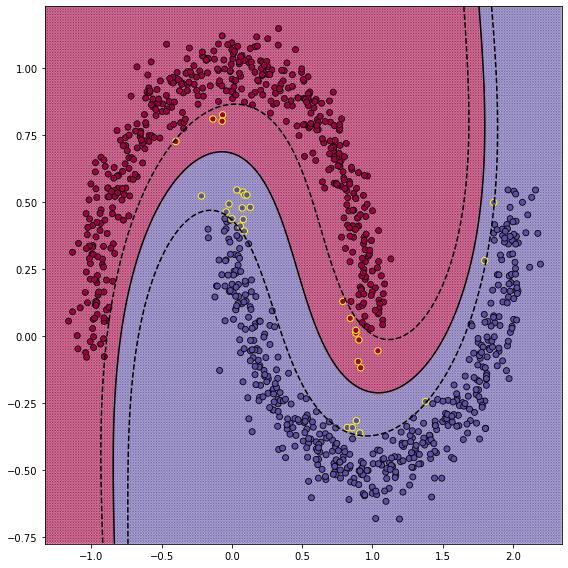

In [61]:
X, y = generate_dataset(True)
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

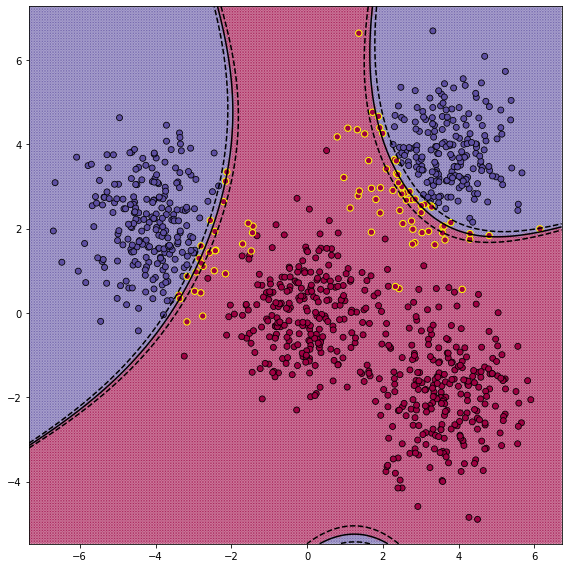

In [62]:
X, y = generate_dataset(False)
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

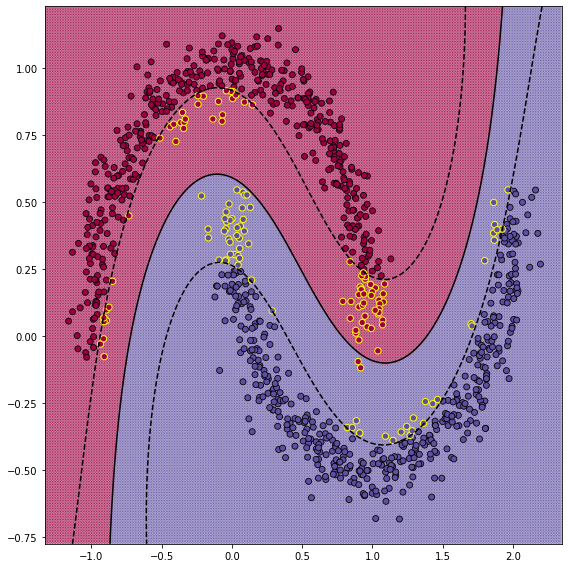

In [63]:
X, y = generate_dataset(True)
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

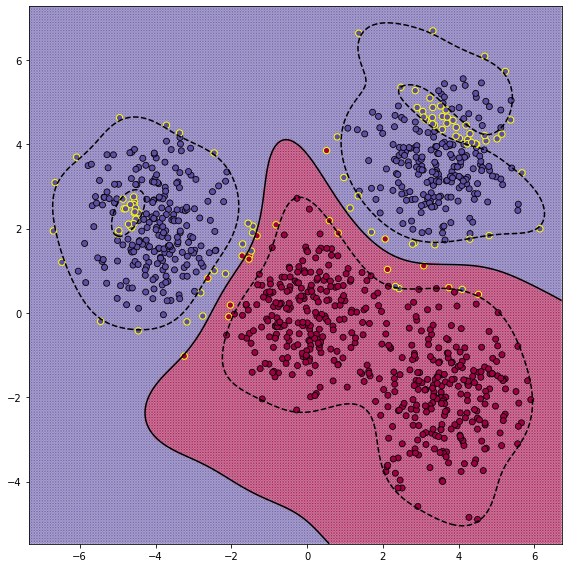

In [64]:
X, y = generate_dataset(False)
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

### Задание 4 (3 балла)
Исследуйте и опишите влияние параметров каждого вида ядра на полученный классификатор. Что происходит при увеличении константы в полиномиальном ядре? При увеличении степени? Как влияет на результат сигма в ядре Гаусса?

__При выполнении этого задания стоит написать код, который визуализирует классификаторы с различными ядрами__

In [44]:
def visualize_several(clf, X, y):
    x_min, x_max = X[:, 0].min(), X[:, 0].max()
    y_min, y_max = X[:, 1].min(), X[:, 1].max()
    x_border = (x_max - x_min) / 20 + 1.0e-3
    x_h = (x_max - x_min + 2 * x_border) / 200
    y_border = (y_max - y_min) / 20 + 1.0e-3
    y_h = (y_max - y_min + 2 * y_border) / 200
    
    cm = plt.cm.Spectral

    xx, yy = np.meshgrid(np.arange(x_min - x_border, x_max + x_border, x_h), np.arange(y_min - y_border, y_max + y_border, y_h))
    mesh = np.c_[xx.ravel(), yy.ravel()]

    clf_len = len(clf)
    z_class = [0] * clf_len
    fig, axs = plt.subplots(1, clf_len, figsize=(60,15))

    for i in range(clf_len):
        z_class[i] = clf[i].predict(mesh).reshape(xx.shape)

        axs[i].pcolormesh(xx, yy, z_class[i], cmap=cm, alpha=0.3, shading='gouraud')
        # Plot hyperplane and margin
        z_dist = clf[i].decision_function(mesh).reshape(xx.shape)
        axs[i].contour(xx, yy, z_dist, [0.0], colors='black')
        axs[i].contour(xx, yy, z_dist, [-1.0, 1.0], colors='black', linestyles='dashed')
        y_pred = clf[i].predict(X)

        ind_support = []
        ind_correct = []
        ind_incorrect = []
        for j in range(len(y)):
            if j in clf[i].support:
                ind_support.append(j)
            elif y[j] == y_pred[j]:
                ind_correct.append(j)
            else:
                ind_incorrect.append(j)

        axs[i].scatter(X[ind_correct, 0], X[ind_correct, 1], c=y[ind_correct], cmap=cm, alpha=1., edgecolor='black', linewidth=.8)
        axs[i].scatter(X[ind_incorrect, 0], X[ind_incorrect, 1], c=y[ind_incorrect], cmap=cm, alpha=1., marker='*',
                  s=50, edgecolor='black', linewidth=.8)
        axs[i].scatter(X[ind_support, 0], X[ind_support, 1], c=y[ind_support], cmap=cm, alpha=1., edgecolor='yellow', linewidths=1.,
                  s=40)
    plt.show()

Сперва поварьируем параметры полиномиального ядра, построив визуализацию работы классификатора на двух датасетах (с лунами и с блобами):


1.   Рассмотрим значения константы C: C=0.1, C=1, C=10, C=100




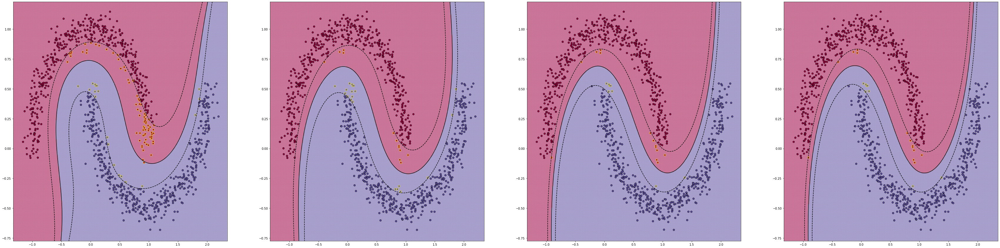

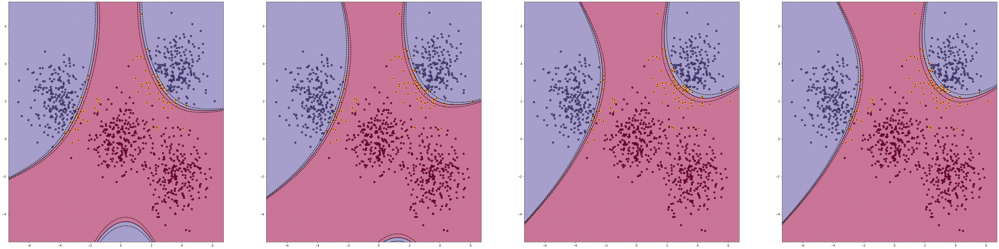

In [45]:
C_param = [0.1,1,10,100]
svm=[0]*len(C_param)
X, y = generate_dataset(moons = True)
for cp in range(len(C_param)):
    new_Ker = KernelSVM(1, kernel=get_polynomial_kernel(C_param[cp],3))
    new_Ker.fit(X, y)
    svm[cp] = new_Ker
visualize_several(svm, X, y)
X, y = generate_dataset(moons = False)
for cp in range(len(C_param)):
    new_Ker = KernelSVM(1, kernel=get_polynomial_kernel(C_param[cp],3))
    new_Ker.fit(X, y)
    svm[cp] = new_Ker
visualize_several(svm, X, y)

Видим, что для значений параметра С<1 классификация происходит не так как хотелось бы (теряется симметричность в случае с лунами), а для С>10 границы перестают изменяться -- большие значения параметра С перестают влиять на результат.

2.   Теперь поварьируем степень в полиномиальном ядре: P=1, P=3, P=5, P=6

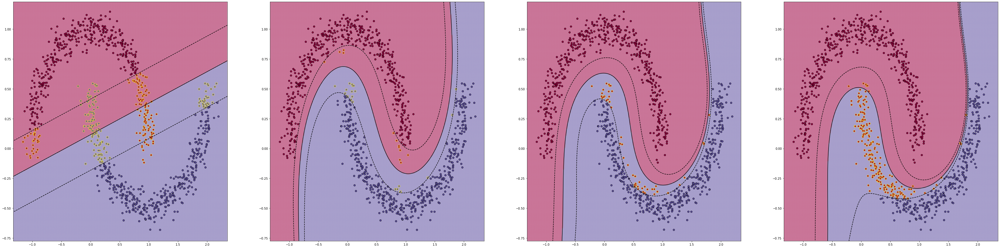

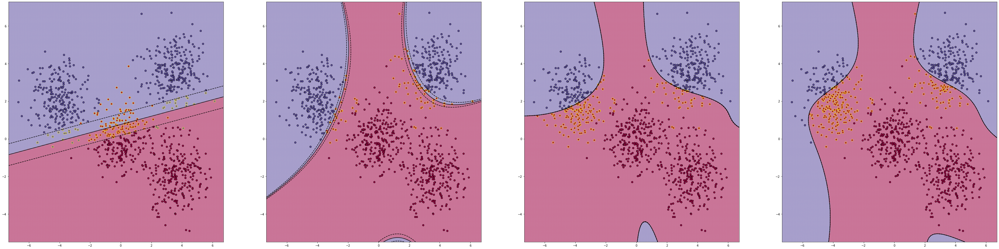

In [46]:
P_param = [1,3,5,6]
svm=[0]*len(C_param)
X, y = generate_dataset(moons = True)
for cp in range(len(P_param)):
    new_Ker = KernelSVM(1, kernel=get_polynomial_kernel(1, P_param[cp]))
    new_Ker.fit(X, y)
    svm[cp] = new_Ker
visualize_several(svm, X, y)
X, y = generate_dataset(moons = False)
for cp in range(len(P_param)):
    new_Ker = KernelSVM(1, kernel=get_polynomial_kernel(1, P_param[cp]))
    new_Ker.fit(X, y)
    svm[cp] = new_Ker
visualize_several(svm, X, y)

Граница разделяющая классы, начиная с линейного вида (P=1), по мере увеличения принимает все более и более сложные формы, для обоих датасетов уже начиная с P=5 разбиение начинает терять смысл/становится не симметричным.

3.   Теперь посмотрим как сигма в гауссовском ядре влияет на результат: $\sigma = 0.1 $, $\sigma  = 0.4 $, $\sigma  = 1$, $\sigma  = 2$.

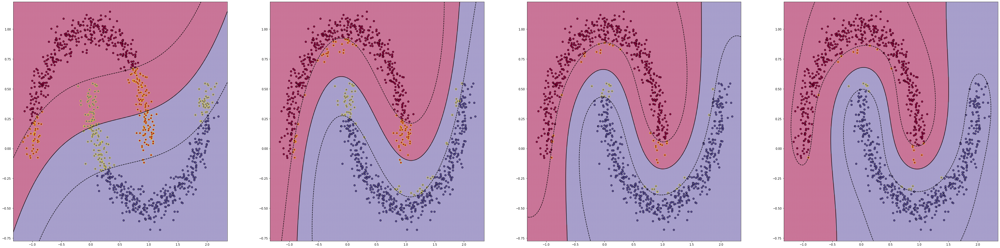

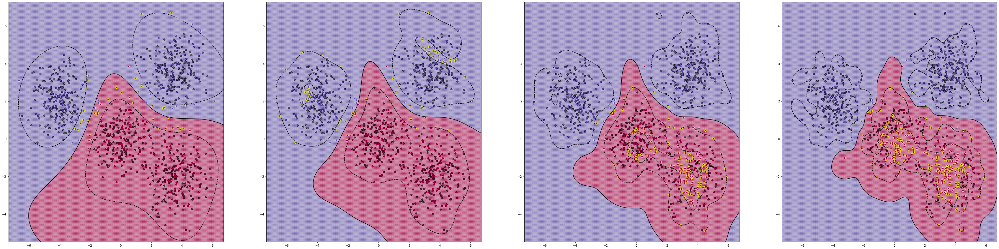

In [47]:
P_param = [0.1,0.4,1,2]
svm=[0]*len(C_param)
X, y = generate_dataset(moons = True)
for cp in range(len(P_param)):
    new_Ker = KernelSVM(1, kernel=get_gaussian_kernel(P_param[cp]))
    new_Ker.fit(X, y)
    svm[cp] = new_Ker
visualize_several(svm, X, y)
X, y = generate_dataset(moons = False)
for cp in range(len(P_param)):
    new_Ker = KernelSVM(1, kernel=get_gaussian_kernel(P_param[cp]))
    new_Ker.fit(X, y)
    svm[cp] = new_Ker
visualize_several(svm, X, y)

При увеличении значения $\sigma$ границы разделения начиная от близких к линейным, становятся все более и более сложными, начиная с $\sigma = 1$ видно уже явное переусложнение.